# Boat Object Detection with YOLO

In this exercise, you will fine-tune a YOLO model for boat detection in satellite imagery.

In [ ]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import requests
import pandas as pd

## Data Collection

Download the training and test datasets.

In [ ]:
# URLs for the dataset files
data_train_features_url = 'https://www.raphaelcousin.com/modules/data-science-practice/module7/exercise/X_train.pkl'
data_train_labels_url = 'https://www.raphaelcousin.com/modules/data-science-practice/module7/exercise/y_train.pkl'
data_test_features_url = 'https://www.raphaelcousin.com/modules/data-science-practice/module7/exercise/X_test.pkl'

def download_file(url, file_name):
    response = requests.get(url)
    response.raise_for_status()
    with open(file_name, 'wb') as file:
        file.write(response.content)
    print(f'Downloaded {file_name}')

# Download the files
download_file(data_train_features_url, 'X_train.pkl')
download_file(data_train_labels_url, 'y_train.pkl')
download_file(data_test_features_url, 'X_test.pkl')

Downloaded X_train.pkl
Downloaded y_train.pkl
Downloaded X_test.pkl


In [ ]:
# Load the training data
with open('X_train.pkl', 'rb') as f:
    X = pickle.load(f)

with open('y_train.pkl', 'rb') as f:
    y = pickle.load(f)

print(f"Loaded {len(X)} training images")
print(f"Sample image shape: {X[0].shape}")
print(f"Sample labels shape: {y[0].shape}")
print(f"Sample labels (YOLO format - class_id, x_center, y_center, width, height):\n{y[0]}")

Loaded 496 training images
Sample image shape: (418, 466, 3)
Sample labels shape: (1, 5)
Sample labels (YOLO format - class_id, x_center, y_center, width, height):
[[0.       0.659871 0.57177  0.109442 0.162679]]


## Data Visualization

Display sample images with bounding boxes.

In [ ]:
def plot_image_with_boxes(image, boxes, ax=None):
    """
    Plot an image with bounding boxes
    boxes: numpy array with shape (n, 5) - [class_id, x_center, y_center, width, height]
    All box coordinates are normalized (0-1)
    """
    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))

    ax.imshow(image)
    height, width = image.shape[:2]

    # Draw each bounding box
    for box in boxes:
        class_id, x_center, y_center, box_width, box_height = box

        # Convert from normalized YOLO format to pixel coordinates
        x_center_px = x_center * width
        y_center_px = y_center * height
        box_width_px = box_width * width
        box_height_px = box_height * height

        # Calculate top-left corner
        x1 = x_center_px - box_width_px / 2
        y1 = y_center_px - box_height_px / 2

        # Draw rectangle
        rect = patches.Rectangle(
            (x1, y1), box_width_px, box_height_px,
            linewidth=2, edgecolor='red', facecolor='none'
        )
        ax.add_patch(rect)

        # Add label
        ax.text(x1, y1-5, 'boat', color='red', fontsize=10,
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))

    ax.axis('off')
    return ax

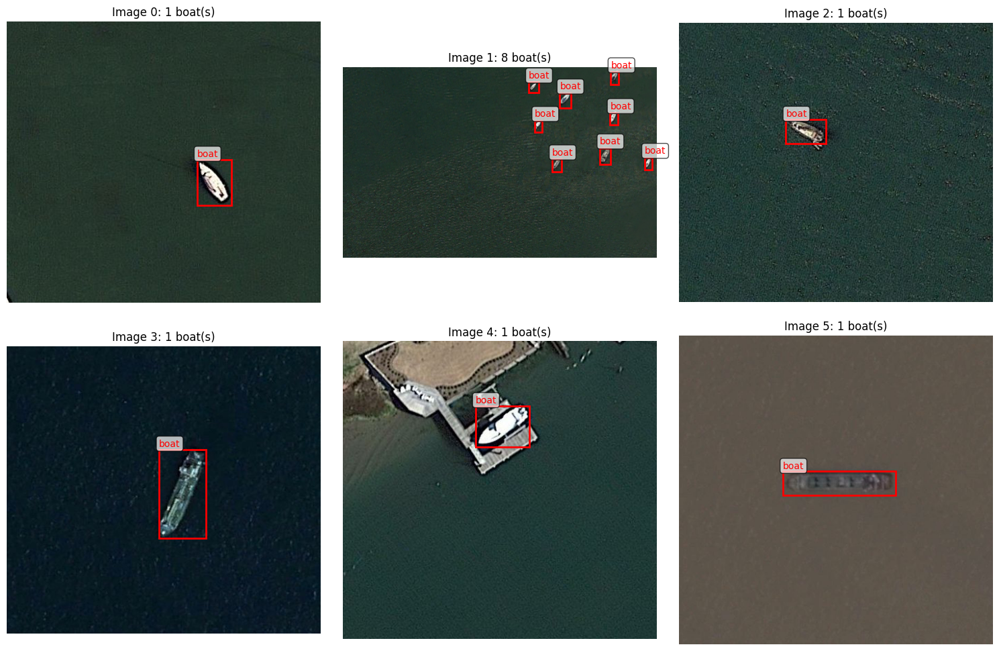

In [ ]:
# Display 5 sample images with bounding boxes
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

for i in range(6):
    plot_image_with_boxes(X[i], y[i], ax=axes[i])
    axes[i].set_title(f'Image {i}: {len(y[i])} boat(s)')

plt.tight_layout()
plt.show()

## Model Setup

Load a pre-trained YOLO model and test it on the training images.

In [ ]:
from ultralytics import YOLO

# Load a pre-trained YOLOv8 model (nano version)
model = YOLO('yolov8n.pt')

print("Model loaded successfully!")

Model loaded successfully!


In [ ]:
# Test the pre-trained model on a sample image
# Save a sample image temporarily
from PIL import Image
sample_img = Image.fromarray(X[0])
sample_img.save('temp_sample.png')

# Run prediction
results = model.predict(source='temp_sample.png', conf=0.25)

print(f"Pre-trained model detected {len(results[0].boxes)} objects")
print("Note: The pre-trained model may not detect boats well - you need to fine-tune it!")


image 1/1 /content/temp_sample.png: 576x640 1 tennis racket, 49.6ms
Speed: 4.1ms preprocess, 49.6ms inference, 1.7ms postprocess per image at shape (1, 3, 576, 640)
Pre-trained model detected 1 objects
Note: The pre-trained model may not detect boats well - you need to fine-tune it!


## Fine-tune your YOLO model

Your task is to fine-tune the YOLO model on the boat detection dataset to achieve a mAP50 score of at least 0.73 on the test set.

In [ ]:
# Your code here
# Fine-tune the YOLO model
# Your code here
# Fine-tune the YOLO model
import os
import yaml

# Create directories for YOLO format
os.makedirs('dataset/images/train', exist_ok=True)
os.makedirs('dataset/labels/train', exist_ok=True)

# Save images and labels in YOLO format
for idx, (image, boxes) in enumerate(zip(X, y)):
    # Save image
    img_path = f'dataset/images/train/image_{idx}.png'
    Image.fromarray(image).save(img_path)

    # Save labels
    label_path = f'dataset/labels/train/image_{idx}.txt'
    with open(label_path, 'w') as f:
        for box in boxes:
            # YOLO format: class_id x_center y_center width height
            f.write(f'0 {box[1]} {box[2]} {box[3]} {box[4]}\n')

# Create YAML configuration file
data_yaml = {
    'train': './dataset/images/train',  # training images path
    'val': './dataset/images/train',     # validation images path (using same as train for this exercise)
    'nc': 1,                            # number of classes
    'names': ['boat']                   # class names
}

with open('dataset.yaml', 'w') as f:
    yaml.dump(data_yaml, f)

# Fine-tune the model
# Using higher imgsz for better detection of small boats
# Using higher epochs for better convergence
# Using a relatively high batch size for faster training
results = model.train(
    data='dataset.yaml',
    epochs=30,
    imgsz=640,
    batch=16,
    optimizer='Adam',
    lr0=0.001,
    weight_decay=0.0005,
    box=9.0,        # focus fort sur la localisation
    cls=0.8,        # équilibrer un peu la classification
    dfl=2.0,        # raffinement pour petits objets
    close_mosaic=15,
    amp=True,
    patience=20
)

best_model_path = model.export()  # Exports the best model
print(f"Model saved to: {best_model_path}")

print("Training completed!")
print(f"Best mAP50 score: {max(results.results_dict['metrics/mAP50(B)']):.3f}")



Ultralytics 8.3.222 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=9.0, cache=False, cfg=None, classes=None, close_mosaic=15, cls=0.8, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset.yaml, degrees=0.0, deterministic=True, device=None, dfl=2.0, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train4, nbs=64, nms=False, opset=None, optimize=False, optimizer=Adam, overlap_mask=True, patience=20, perspective=0.0, plots=True, pose=12.0, pretrained

TypeError: 'float' object is not iterable

In [ ]:
best_model_path

'/content/runs/detect/train4/weights/best.torchscript'

In [ ]:
model = YOLO(best_model_path)  # chemin vers le meilleur modèle

## Generate Predictions for Test Set

Generate predictions on the test set and save them in the required CSV format.

In [ ]:
# Load test data
with open('X_test.pkl', 'rb') as f:
    X_test = pickle.load(f)

print(f"Loaded {len(X_test)} test images")

Loaded 125 test images


In [ ]:
type(X_test) #liste
len(X_test) #nbr d'image: 125
X_test[7].shape #dimensions de la 7ème image
#Les images n'ont ni les mêmes (width,height) ni le même nombre de canaux (3 ou 4)


(428, 462, 3)

array([[231, 231, 231, ..., 231, 231, 231],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
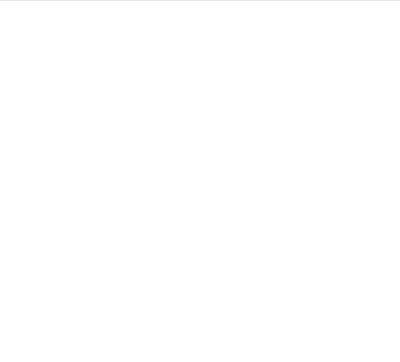

In [ ]:
img = X_test[0]
img[...,3]

In [ ]:
img = X_test[0]
img = img[...,:3]
img.shape

(362, 400, 3)

In [ ]:
img.dtype

dtype('uint8')

In [ ]:
import numpy as np

X_test_clean = []

for img in X_test:
    # Supprime le canal alpha si présent
    if img.shape[-1] == 4:
        img = img[..., :3]

    # S'assure que les valeurs sont entières entre 0 et 255
    if img.dtype != np.uint8:
        img = (img * 255).clip(0, 255).astype(np.uint8)

    X_test_clean.append(img)

print(f"{len(X_test_clean)} images nettoyées")
print("Exemple :", X_test_clean[0].shape, X_test_clean[0].dtype)


125 images nettoyées
Exemple : (362, 400, 3) uint8


In [ ]:
# Generate predictions on test set
# Your trained model should be used here
# Format: CSV with columns: image_id, box_idx, class_id, confidence, x_center, y_center, width, height

predictions = []



for img_idx, img in enumerate(X_test_clean):
    temp_img = Image.fromarray(img)
    temp_img.save('temp_test.png')


    # Run prediction with your fine-tuned model
    # Replace 'model' with your fine-tuned model
    results = model.predict(source='temp_test.png', conf=0.25, verbose=False)

    # Extract predictions
    for box_idx, box in enumerate(results[0].boxes):
        # Get box data in YOLO format (normalized coordinates)
        x_center, y_center, width, height = box.xywhn[0].cpu().numpy()
        confidence = box.conf[0].cpu().numpy()
        class_id = int(box.cls[0].cpu().numpy())

        predictions.append({
            'image_id': img_idx,
            'box_idx': box_idx,
            'class_id': 0,  # Always 0 for boat
            'confidence': float(confidence),
            'x_center': float(x_center),
            'y_center': float(y_center),
            'width': float(width),
            'height': float(height)
        })

    if (img_idx + 1) % 10 == 0:
        print(f"Processed {img_idx + 1}/{len(X_test)} images")

print(f"\nTotal predictions: {len(predictions)}")

Loading /content/runs/detect/train4/weights/best.torchscript for TorchScript inference...
Processed 10/125 images
Processed 20/125 images
Processed 30/125 images
Processed 40/125 images
Processed 50/125 images
Processed 60/125 images
Processed 70/125 images
Processed 80/125 images
Processed 90/125 images
Processed 100/125 images
Processed 110/125 images
Processed 120/125 images

Total predictions: 467


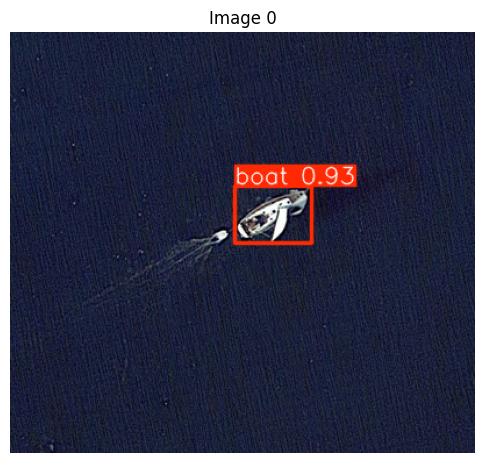

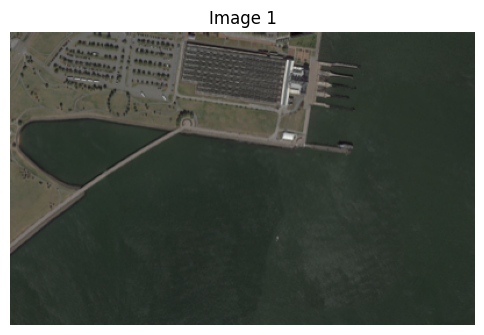

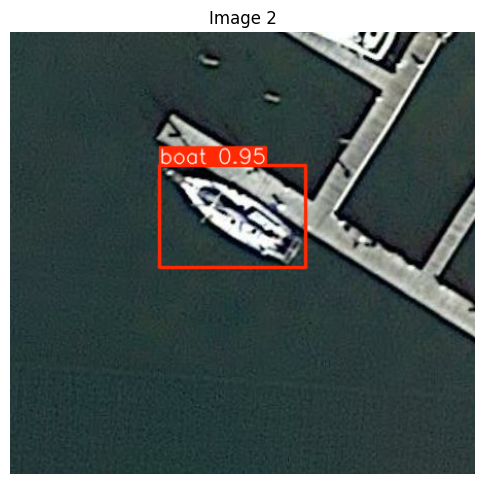

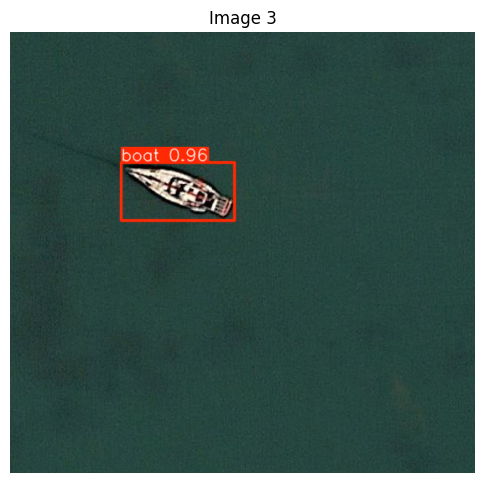

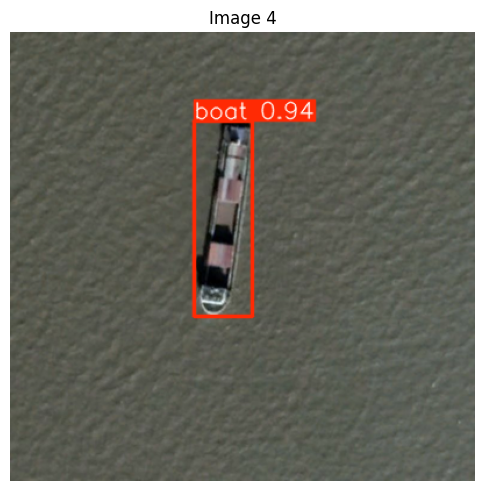

...

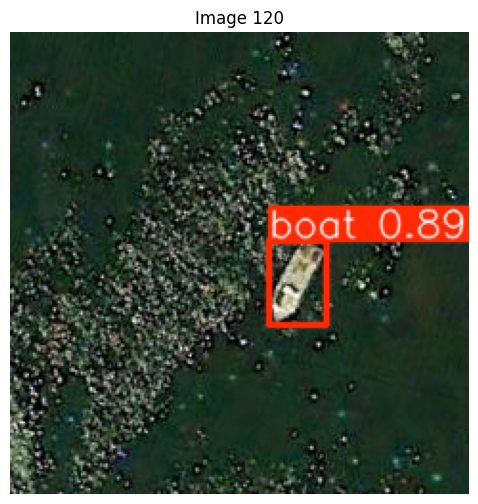

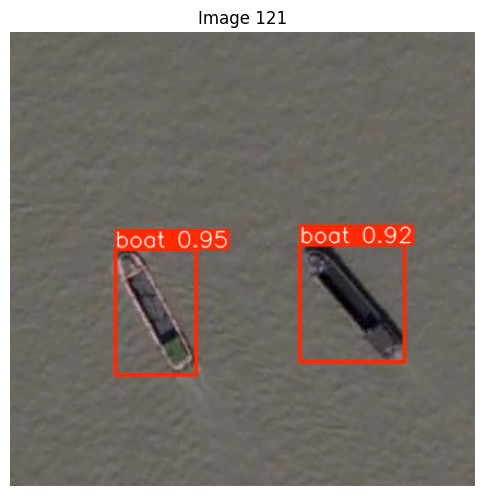

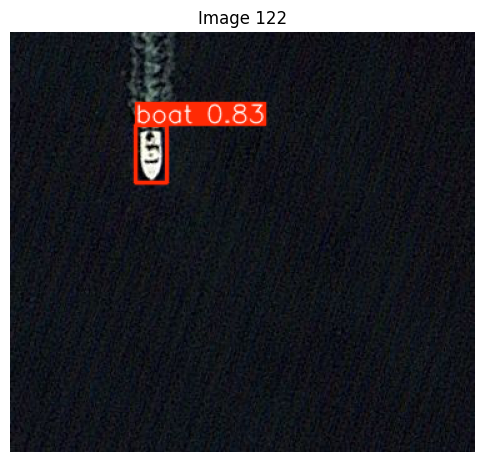

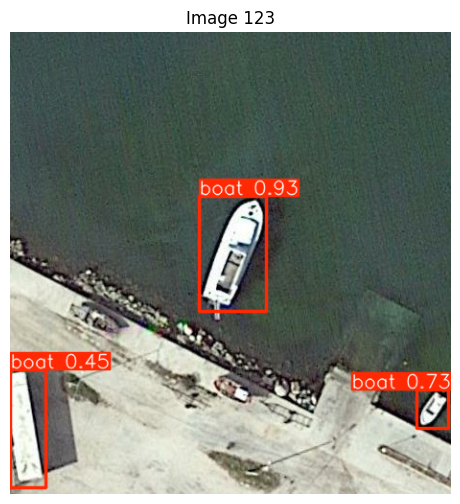

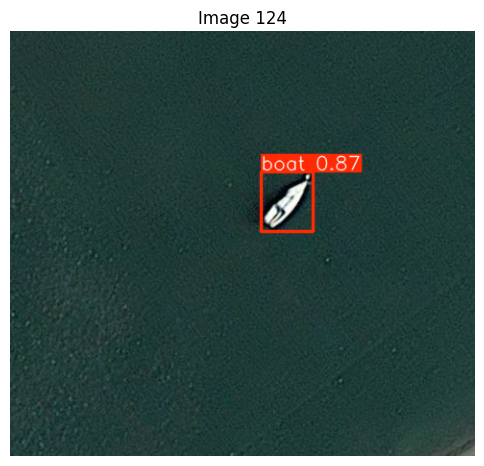

In [ ]:

import matplotlib.pyplot as plt

for i in range(125):  # affiche les 5 premières
    results = model.predict(source=X_test_clean[i], conf=0.25)
    annotated_img = results[0].plot()
    plt.figure(figsize=(6,6))
    plt.imshow(annotated_img)
    plt.title(f"Image {i}")
    plt.axis('off')
    plt.show()


In [ ]:
# Save predictions to CSV
df_predictions = pd.DataFrame(predictions)
df_predictions.to_csv('predictions.csv', index=False)

print("Predictions saved to predictions.csv")
print("\nFirst few predictions:")
print(df_predictions.head(10))